In [1]:
import peakutils
import numpy as np
from peakutils.plot import plot as pplot
import matplotlib.pyplot as plt

## Load data ##

In [7]:
def find_nearest(array,value):
    idx = (np.abs(array-value)).argmin()
    return idx


def loaddata(data_filename):
    """load matrix data"""
    data = np.genfromtxt(data_filename, delimiter='\t')
    data_nm = data[1:,0]    #wavelength in nm
    data_time = data[0,1:]
    data_z = data[1:, 1:]

    return data_nm, data_time, data_z


def loaddata_timeslice(data_filename):
    """load array data"""
    data = np.genfromtxt(data_filename, delimiter='\t')
    data_nm = data[:,0]    #wavelength in nm
    data_z_array = data[:, 1]

    return data_nm, data_z_array


## Find peak and its property ##

In [8]:
def findpeak(data_z_array, threshold, min_dist):
    """find peaks and return indices of the peaks"""    
    peak_indices = peakutils.indexes(data_z_array, thres=threshold, min_dist=min_dist)
    
    return peak_indices


def peakchar(data_nm, data_z_array, peak_index):
    """find the peak width, and intensity"""
    num_peaks = len(peak_index)
    
    #array of peak height
    height = [data_z_array[idx] for idx in peak_index]
    
    #array of peak width
    half_height = [ht / 2 for ht in height]

    fwhm_idx_1 = np.empty_like(half_height)
    fwhm_idx_2 = np.empty_like(fwhm_idx_1)
    fwhm_nm_1 = np.empty_like(fwhm_idx_1)
    fwhm_nm_2 = np.empty_like(fwhm_idx_1)
    
    for i in range(num_peaks):
        #find the index and nmof the left side of the fwhm
        if i == 0:
            fwhm_idx_1[i] = find_nearest(data_z_array[0:peak_index[i]], half_height[i])
        else:
            fwhm_idx_1[i] = find_nearest(data_z_array[peak_index[i-1]:peak_index[i]], half_height[i]) + peak_index[i-1]

        fwhm_nm_1[i] = data_nm[int(fwhm_idx_1[i])]
        
        #find the index and nm of the right side of the fwhm   
        fwhm_idx_2[i] = find_nearest(data_z_array[peak_index[i]:], half_height[i]) + peak_index[i]

        fwhm_nm_2[i] = data_nm[int(fwhm_idx_2[i])]
    
    #find fwhm
    fwhm = fwhm_nm_2 - fwhm_nm_1

    return height, fwhm

## Example of finding peaks and their properties in a synthetic array containing two gaussian ##

In [3]:
filename = 'twogaussian_array.txt'
nm, z = loaddata_timeslice(filename)

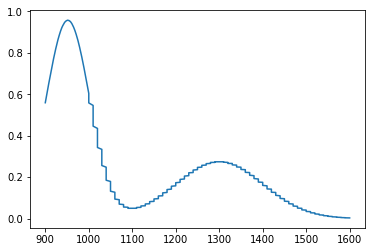

In [4]:
plt.figure()
plt.plot(nm, z)

## Output height and FWHM of the peaks ##

In [5]:
peak_idx = findpeak(z, 0, 0)
peak_height, peak_fwhm = peakchar(nm, z, peak_idx)


print (peak_height)
print (peak_fwhm)

[0.957, 0.274]
[110. 240.]


In [6]:
def peak_matrix(nm_array,data_matrix,num_timeslice, threshold, mindist):
    """find peaks in a data matrix"""
    peak_idx_matx = np.zeros((num_timeslice,2))
    peak_height_matx = np.empty_like(peak_idx_matx)
    peak_fwhm_matx = np.empty_like(peak_height_matx)
    
    for i in range(num_timeslice):
        data_timeslice = data_matrix[:, i]
        
        peak_idx = findpeak(data_timeslice, threshold, mindist)
        
        peak_idx_matx[i, :] = peak_idx
        
        peak_height, peak_fwhm = peakchar(nm, data_timeslice, peak_idx)
        peak_height_matx[i, :], peak_fwhm_matx[i, :] = peak_height, peak_fwhm 
        
    return peak_idx_matx, peak_height_matx, peak_fwhm_matx

In [66]:
filename = '20180418_twogaussian_spectralshfit.txt'
nm, time, z = loaddata(filename)
num_timeslice = 3

In [67]:
peak_idx_matx, peak_height_matx, peak_fwhm_matx = peak_matrix(nm,z,num_timeslice, 0, 0)

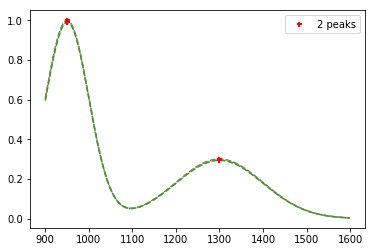

In [68]:
plt.figure()
for i in range(num_timeslice):
    #plt.plot(nm, z[:, 0:3])
    pplot(nm, z[:, i], peak_idx_matx[i, :].astype('int64'))
#pplot(x, m[:,i],peak[i,:].astype('int64'))

In [10]:
def Earth_Smoothing(nm_array, timedelay, noise_coefficient):
    import numpy
    import matplotlib.pyplot as plt
    from pyearth import Earth
    
    """
     ============================================
     Plotting derivatives of simple sine function
    ============================================

     A simple example plotting a fit of the sine function
    and the derivatives computed by Earth.
    
    Notes
    -----   
    generates a denoise curve from the TA data
    Parameters
    ----------
        nm_array: wavelength array
        timedelay: intensity array
        noise_coefficient: the noise coefficients that user want to generate
    Returns
    -------
        a smoothing curve from the original noise curve   
    """
    # Create some fake data
    # generate some noisy data from syntheticdata:
    np.random.seed(1729)
    y_noise = noise_coefficient * np.random.normal(size=nm_array.size)
    ydata = timedelay + y_noise
    
   # Fit an Earth model
    model = Earth(max_degree=2, minspan_alpha=.5, smooth=True)
    model.fit(nm_array, ydata)

   # Print the model
    print(model.trace())
    print(model.summary())

   # Get the predicted values and derivatives
    y_hat = model.predict(nm_array)

    # Plot true and predicted function values 
    plt.figure(figsize=(15,8))
    plt.title('Peak Smoothening', fontsize = 16, fontweight = 'bold')
    plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
    plt.ylabel('Intensity', fontsize = 16, fontweight = 'bold')
    plt.xticks(fontsize = 14)
    plt.yticks(fontsize = 14)
    plt.plot(nm_array, ydata, 'r.')
    plt.plot(nm_array, y_hat, 'b.')
    plt.ylabel('function')
    
    return


In [22]:
def savitzky_golay(y, window_size, order, deriv=0, rate=1):
    
    """Smooth (and optionally differentiate) data with a Savitzky-Golay filter.
    The Savitzky-Golay filter removes high frequency noise from data.
    It has the advantage of preserving the original shape and
    features of the signal better than other types of filtering
    approaches, such as moving averages techniques.
    
    Parameters
    ----------
    y : array_like, shape (N,)
        the values of the time history of the signal.
    window_size : int
        the length of the window. Must be an odd integer number.
    order : int
        the order of the polynomial used in the filtering.
        Must be less then `window_size` - 1.
    deriv: int
        the order of the derivative to compute (default = 0 means only smoothing)
    Returns
    -------
    ys : ndarray, shape (N)
        the smoothed signal (or it's n-th derivative).
    Notes
    -----
    The Savitzky-Golay is a type of low-pass filter, particularly
    suited for smoothing noisy data. The main idea behind this
    approach is to make for each point a least-square fit with a
    polynomial of high order over a odd-sized window centered at
    the point.

    """
    import numpy as np
    from math import factorial

    try:
        window_size = np.abs(np.int(window_size))
        order = np.abs(np.int(order))
    except ValueError:
        raise ValueError("window_size and order have to be of type int")
    if window_size % 2 != 1 or window_size < 1:
        raise TypeError("window_size size must be a positive odd number")
    if window_size < order + 2:
        raise TypeError("window_size is too small for the polynomials order")
    order_range = range(order+1)
    half_window = (window_size -1) // 2
    # precompute coefficients
    b = np.mat([[k**i for i in order_range] for k in range(-half_window, half_window+1)])
    m = np.linalg.pinv(b).A[deriv] * rate**deriv * factorial(deriv)
    # pad the signal at the extremes with
    # values taken from the signal itself
    firstvals = y[0] - np.abs( y[1:half_window+1][::-1] - y[0] )
    lastvals = y[-1] + np.abs(y[-half_window-1:-1][::-1] - y[-1])
    y = np.concatenate((firstvals, y, lastvals))
    return np.convolve( m[::-1], y, mode='valid')

def savitzky_golay_smoothing(nm_array, timedelay, noise_coefficient):
    import numpy as np
    import scipy.fftpack
    from matplotlib import pyplot as plt
    
    
    """
    Notes
    -----   
    generates a denoise curve from the TA data
    Parameters
    ----------
        nm_array: wavelength array
        timedelay: intensity array
        noise_coefficient: the noise coefficients that user want to generate
    Returns
    -------
        a smoothing curve from the original noise curve   
    """
 
   # generate some noisy data from syntheticdata:
    np.random.seed(1729)
    y_noise = noise_coefficient * np.random.normal(size=nm_array.size)
    ydata = timedelay + y_noise
    y_hat = savitzky_golay(ydata, 51, 3) # window size 51, polynomial order 3
    
   # plot the noise data curve and denoise curve
    plt.figure()
    plt.title('Peak Smoothening', fontsize = 16, fontweight = 'bold')
    plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
    plt.ylabel('Intensity', fontsize = 16, fontweight = 'bold')
    plt.xticks(fontsize = 14)
    plt.yticks(fontsize = 14)
    plt.plot(nm_array,ydata)
    plt.plot(nm_array,y_hat, color='red')
    
    plt.show()
    return ydata, y_hat

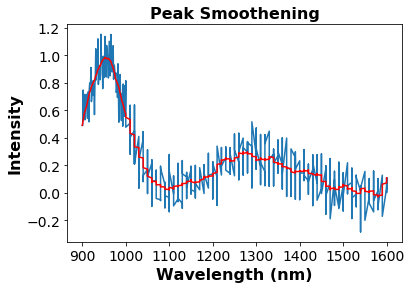

In [23]:
filename = 'twogaussian_array.txt'
nm, z = loaddata_timeslice(filename)
noise_coefficient = 0.1
smooth = savitzky_golay_smoothing(nm, z, noise_coefficient)

## Smoothening a data matrix ##

In [25]:
def smooth_matrix(nm_array,data_matrix,noise_coefficient):
    num_array = np.shape(data_matrix)[1]
    noise_matx = np.empty_like(data_matrix)
    smooth_matx = np.empty_like(data_matrix)
    for i in range(num_array):
        data_array = data_matrix[:, i]
        noise_array, smooth_array = savitzky_golay_smoothing(nm_array, data_array, noise_coefficient)
        noise_matx[:, i] = noise_array
        smooth_matx[:, i] = smooth_array
    
    return noise_matx, smooth_matx

# Data processing of a synthetic matrix and testing algorithm #

## 1. Example of adding noise and denoising  a matrix ##

In [43]:
filename = '20180418_twogaussian_spectralshfit.txt'
nm, time, z = loaddata(filename)

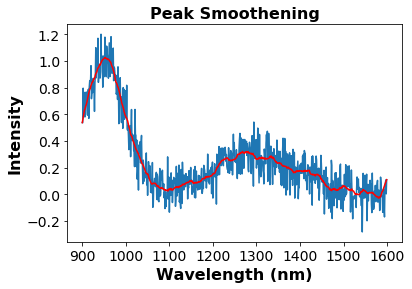

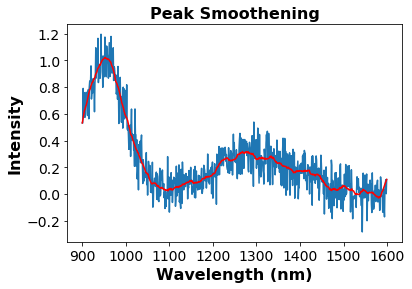

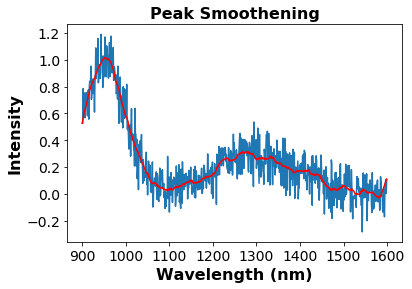

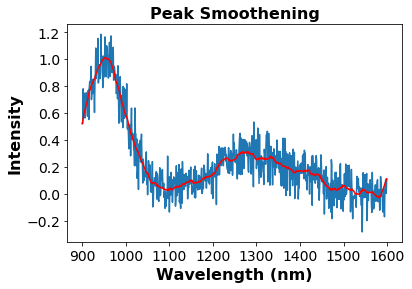

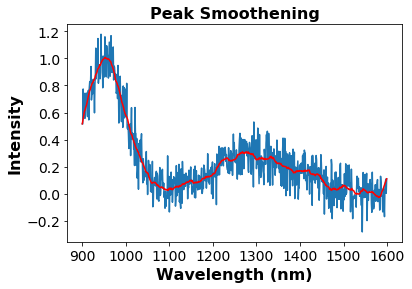

...

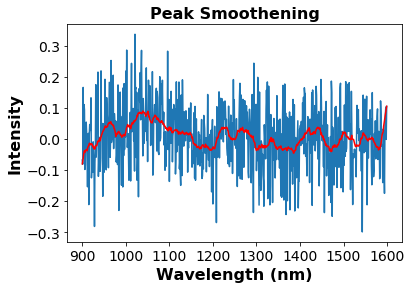

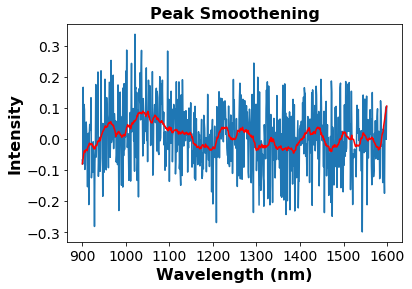

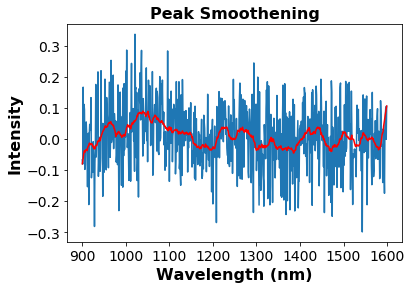

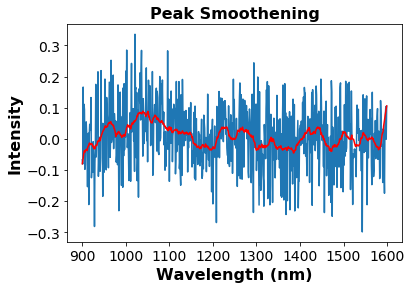

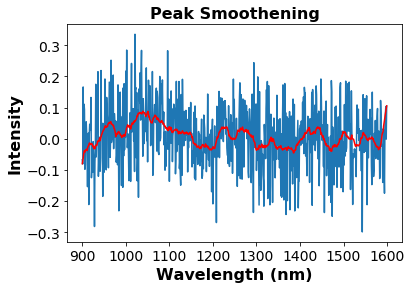

In [44]:
noise_matx_sample, smooth_matx_sample = smooth_matrix(nm, z, noise_coefficient)

In [32]:
def twodcontourplot(tadata_nm, tadata_timedelay, tadata_z_corr):
    """
    make contour plot
    
    Args:
        tadata_nm: wavelength array
        tadata_timedelay: time delay array
        tadata_z_corr: matrix of z values
        
    """
    nm, timedelay = np.linspace(tadata_nm.min(), tadata_nm.max(), 100), np.linspace(tadata_timedelay.min(), tadata_timedelay.max(), 100)    
    timedelayi, nmi = np.meshgrid(tadata_timedelay, tadata_nm)

    #find the maximum and minimum
    #these are used for color bar
    z_min = np.amin(np.amin(tadata_z_corr, axis = 1))
    z_max = np.amax(np.amax(tadata_z_corr, axis = 1))

    
    return [nmi, timedelayi, z_min, z_max]


## Contour plot of original noise-free data ##

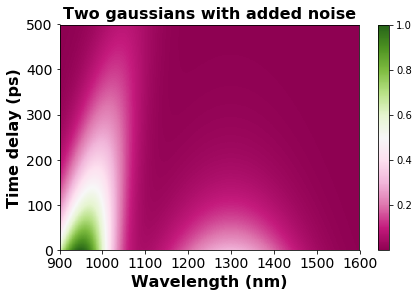

In [45]:
original_contour = twodcontourplot(nm, time, z)
nm_contour, time_contour, min_contour, max_contour = original_contour[0], original_contour[1], original_contour[2], original_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Two gaussians with added noise', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.pcolormesh(nm_contour, time_contour, z, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)

## Contour plot after adding noise ##

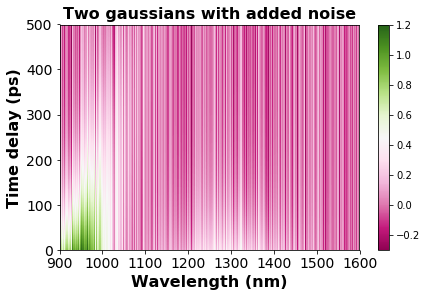

In [46]:
noise_contour = twodcontourplot(nm, time, noise_matx_sample)
nm_contour, time_contour, min_contour, max_contour = noise_contour[0], noise_contour[1], noise_contour[2], noise_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Two gaussians with added noise', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)

plt.pcolormesh(nm_contour, time_contour, noise_matx_sample, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)


## Contour plot after de-noising ##

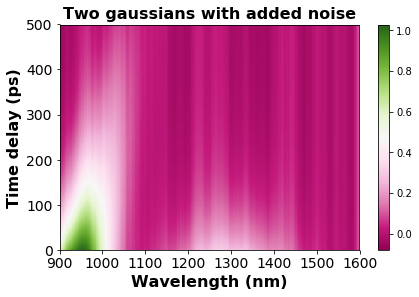

In [47]:
smooth_contour = twodcontourplot(nm, time, smooth_matx_sample)
nm_contour, time_contour, min_contour, max_contour = smooth_contour[0], smooth_contour[1], smooth_contour[2], smooth_contour[3]

plt.figure()
#plt.xlim(450,800)
plt.title('Two gaussians with added noise', fontsize = 16, fontweight = 'bold')
#plt.ylim(0,50)
plt.xlabel('Wavelength (nm)', fontsize = 16, fontweight = 'bold')
plt.ylabel('Time delay (ps)', fontsize = 16, fontweight = 'bold')
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)

plt.pcolormesh(nm_contour, time_contour, smooth_matx_sample, cmap = 'PiYG', vmin=min_contour, vmax=max_contour)
plt.colorbar()
plt.tight_layout(pad=0.25, h_pad=None, w_pad=None, rect=None)


## 2. Find peaks, peak height and peak fwhm in smoothened data ##

In [74]:
num_timeslice = np.shape(smooth_matx_sample)[1]
peak_idx_matx, peak_height_matx, peak_fwhm_matx = peak_matrix(nm,smooth_matx_sample,num_timeslice, 0.05, 300)

## Plot time slices and peaks found (red dots) ##

### Problem ###
* very sensitive to noise when S/N is low

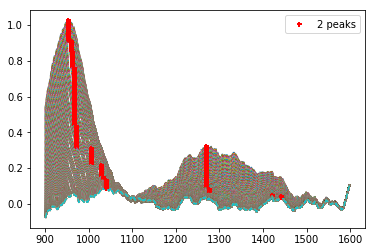

In [75]:
for i in range(num_timeslice):
    pplot(nm, smooth_matx_sample[:, i], peak_idx_matx[i, :].astype('int64'))

### Plot peak height over time ###

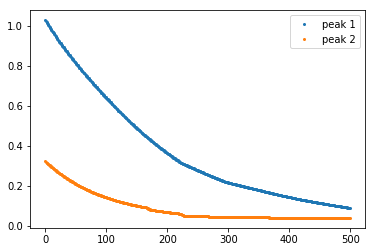

In [82]:
plt.figure()
plt.plot(time, peak_height_matx[:,0], 'o', markersize = 2, label = 'peak 1')
plt.plot(time, peak_height_matx[:,1], 'o', markersize = 2, label = 'peak 2')
plt.legend()

### Plot peak width over time ###

* Calculation doesn't really work... yet...

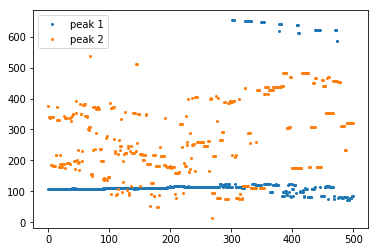

In [83]:
plt.figure()
plt.plot(time, peak_fwhm_matx[:,0], 'o', markersize = 2, label = 'peak 1')
plt.plot(time, peak_fwhm_matx[:,1], 'o', markersize = 2, label = 'peak 2')
plt.legend()